In [1]:
import os
import glob
import time
import math
import random
from datetime import timedelta
from collections import OrderedDict

import cv2
import numpy as np 
import pandas as pd

import matplotlib.pyplot as plt 

import pickle

import pims

from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable, Function

import torchvision
from torchvision import datasets, models, transforms
import torchvision.models as models

from torch.optim import lr_scheduler
from torch.utils.data import TensorDataset, DataLoader,random_split

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler

import wandb

from tqdm.auto import tqdm

import seaborn as sn

import umap
import umap.umap_ as UMAP

/home/anagara8/.conda/envs/pytorch/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Autoencoder Model

In [2]:
class ResizeConv2d(nn.Module):

    def __init__(self, in_channels, out_channels, kernel_size, scale_factor, mode='nearest'):
        super().__init__()
        self.scale_factor = scale_factor
        self.mode = mode
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=1)

    def forward(self, x):
        x = F.interpolate(x, scale_factor=self.scale_factor, mode=self.mode)
        x = self.conv(x)
        return x

class BasicBlockEnc(nn.Module):

    def __init__(self, in_planes, stride=1):
        super().__init__()

        planes = in_planes*stride

        self.conv1 = nn.Conv2d(in_planes, planes, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)

        if stride == 1:
            self.shortcut = nn.Sequential()
        else:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_planes, planes, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes)
            )

    def forward(self, x):
        out = torch.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += self.shortcut(x)
        out = torch.relu(out)
        return out

class BasicBlockDec(nn.Module):

    def __init__(self, in_planes, stride=1):
        super().__init__()

        planes = int(in_planes/stride)

        self.conv2 = nn.Conv2d(in_planes, in_planes, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(in_planes)
        # self.bn1 could have been placed here, but that messes up the order of the layers when printing the class

        if stride == 1:
            self.conv1 = nn.Conv2d(in_planes, planes, kernel_size=3, stride=1, padding=1, bias=False)
            self.bn1 = nn.BatchNorm2d(planes)
            self.shortcut = nn.Sequential()
        else:
            self.conv1 = ResizeConv2d(in_planes, planes, kernel_size=3, scale_factor=stride)
            self.bn1 = nn.BatchNorm2d(planes)
            self.shortcut = nn.Sequential(
                ResizeConv2d(in_planes, planes, kernel_size=3, scale_factor=stride),
                nn.BatchNorm2d(planes)
            )

    def forward(self, x):
        out = torch.relu(self.bn2(self.conv2(x)))
        out = self.bn1(self.conv1(out))
        out += self.shortcut(x)
        out = torch.relu(out)
        return out

class ResNet18Enc(nn.Module):
    def __init__(self, z_dim=32):
        super(ResNet18Enc, self).__init__()
        self.z_dim = z_dim
        self.ResNet18 = models.resnet18(pretrained=True)
        self.num_feature = self.ResNet18.fc.in_features
        self.ResNet18.fc = nn.Linear(self.num_feature, 1*self.z_dim)
        
    def forward(self, x):
        x = self.ResNet18(x)
        return x

class ResNet18Dec(nn.Module):

    def __init__(self, num_Blocks=[2,2,2,2], z_dim=32, nc=3):
        super().__init__()
        self.in_planes = 512

        self.linear = nn.Linear(z_dim, 512)

        self.layer4 = self._make_layer(BasicBlockDec, 256, num_Blocks[3], stride=2)
        self.layer3 = self._make_layer(BasicBlockDec, 128, num_Blocks[2], stride=2)
        self.layer2 = self._make_layer(BasicBlockDec, 64, num_Blocks[1], stride=2)
        self.layer1 = self._make_layer(BasicBlockDec, 64, num_Blocks[0], stride=1)
        self.conv1 = ResizeConv2d(64, nc, kernel_size=3, scale_factor=2)

    def _make_layer(self, BasicBlockDec, planes, num_Blocks, stride):
        strides = [stride] + [1]*(num_Blocks-1)
        layers = []
        for stride in reversed(strides):
            layers += [BasicBlockDec(self.in_planes, stride)]
        self.in_planes = planes
        return nn.Sequential(*layers)

    def forward(self, z):
        x = self.linear(z)
        x = x.view(z.size(0), 512, 1, 1)
        x = F.interpolate(x, scale_factor=7)
        x = self.layer4(x)
        x = self.layer3(x)
        x = self.layer2(x)
        x = self.layer1(x)
        x = F.interpolate(x, size=(112,112), mode='bilinear')
        x = torch.sigmoid(self.conv1(x))
        # [x, channels, height, width]
        x = x.view(x.size(0), 3, 224, 224)
        return x

class newAE(nn.Module):

    def __init__(self, z_dim):
        super(newAE, self).__init__()
        self.encoder = ResNet18Enc(z_dim=z_dim)
        self.decoder = ResNet18Dec(z_dim=z_dim)

    def forward(self, x):
        z = self.encoder(x)
#         mean, logvar = self.encoder(x)
#         z = self.reparameterize(mean, logvar)
        x = self.decoder(z)
        return x

    @staticmethod
    def reparameterize(mean, logvar):
        std = torch.exp(logvar / 2) # in log-space, squareroot is divide by two
        epsilon = torch.randn_like(std)
        return epsilon * std + mean

In [3]:
start = time.time()
training_data_list = np.load("/media/data_cifs/anagara8/OnePercentFramesList.npy")
end = time.time()
print("Training File List Loading Time:", end - start)

Training File List Loading Time: 28.52240300178528


### NIH Dataset

In [4]:
class NIHDataset(torch.utils.data.Dataset):
    def __init__(self, img_list, augmentations = None):
        super(NIHDataset, self).__init__()
        self.img_list = img_list
        self.augmentations = augmentations
    
    def __len__(self):
        return len(self.img_list)

    def __getitem__(self, idx):
        # Load Image using PIL
        img = Image.open(self.img_list[idx])
        # Resize to 224x224
        img = torchvision.transforms.Resize((224, 224))(img)
        # Need to convert to a Tensor, Resize doesn't return a Tensor
        img = torchvision.transforms.ToTensor()(img)
        return img

### Loading the Data

In [5]:
m = len(training_data_list)

print("Length:",m, "-> Training set size:", int(math.ceil(m-m*0.2)), "| Validation set size:", int(m*0.2))
train_data, val_data = random_split(training_data_list, [int(math.ceil(m-m*0.2)), int(m*0.2)])

Length: 8086880 -> Training set size: 6469504 | Validation set size: 1617376


In [6]:
batch_size=16
# train_set_loader = torch.utils.data.DataLoader(NIHDataset(train_data), batch_size=batch_size, num_workers = 4, shuffle=True)
valid_set_loader = torch.utils.data.DataLoader(NIHDataset(val_data), batch_size=batch_size, num_workers = 4, shuffle=True)
# test_set_loader = torch.utils.data.DataLoader(NIHDataset(test_dataset_list), batch_size=batch_size,shuffle=True, num_workers = 4)
print("Converted to DataLoader")

Converted to DataLoader


#### Utility Functions

In [7]:
def show_image(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))

def plot_manipulated_latents(model, manipulation_value=1, image_index=0, n=32):
    
    total_loss = 0.0
    plt.figure(figsize=(200, 1600))
    
    # Loop over every single latent value
    for i in range(n):
        # Initialize subplot
        figure, (ax1, ax2, ax3, ax4) = plt.subplots(1,4)
        figure.set_figheight(150)
        figure.set_figwidth(150)
        # Get Target Image
        img = valid_set_loader.dataset[image_index].unsqueeze(0).cuda()
        
        model.eval()
        with torch.no_grad():
            if len(model(img))>1:
                # This case doesn't usually occur, but leaving it here for easier debugging
                rec_img, _, _  = model(img)
            else:
                # Getting the Latent representation
                latent_representation = model.module.encoder(img).squeeze().cpu().numpy()
                
                # Getting the reconstuction from unmanipulated latents
                reconstructed_image = model.module.decoder(torch.tensor([latent_representation]).cuda())
                
                # Storing the original latent value at position i
                original_value = latent_representation[i]
                
                # Adding the `manipulation_value` to the latent value at position i
                latent_representation[i] = original_value + manipulation_value
                plus_manipulated_reconstruction = model.module.decoder(torch.tensor([latent_representation]).cuda())
                
                # Subtracting the `manipulation_value` to the latent value at position i
                latent_representation[i] = original_value - manipulation_value
                minus_manipulated_reconstruction = model.module.decoder(torch.tensor([latent_representation]).cuda())
                
                # Restoring the original latent value to debug
                latent_representation[i] = original_value
        
        # Original Image
        original_image = torch.permute(img[0].cpu(), (1, 2, 0))
        ax1.imshow(original_image, cmap='gist_gray')
        ax1.get_xaxis().set_visible(False)
        ax1.get_yaxis().set_visible(False)
        
        # Reconstruction from untouched latents
        reconstructed_image = torch.permute(reconstructed_image[0].cpu(), (1, 2, 0))
        ax2.imshow(reconstructed_image, cmap='gist_gray')  
        ax2.get_xaxis().set_visible(False)
        ax2.get_yaxis().set_visible(False)
        
        # Reconstruction from addition manipulated latents
        plus_manipulated_reconstruction = torch.permute(plus_manipulated_reconstruction[0].cpu(), (1, 2, 0))
        ax3.imshow(plus_manipulated_reconstruction, cmap='gist_gray')
        ax3.get_xaxis().set_visible(False)
        ax3.get_yaxis().set_visible(False)
        
        # Reconstruction from subtraction manipulated latents
        minus_manipulated_reconstruction = torch.permute(minus_manipulated_reconstruction[0].cpu(), (1, 2, 0))
        ax4.imshow(minus_manipulated_reconstruction, cmap='gist_gray')
        ax4.get_xaxis().set_visible(False)
        ax4.get_yaxis().set_visible(False)
        
        plt.show()
        print("Change value of the latent at position", i, "from", original_value, "to", 
              latent_representation[i]+manipulation_value, "(+) and", 
              latent_representation[i]-manipulation_value, "(-)")
    

<Figure size 14400x115200 with 0 Axes>

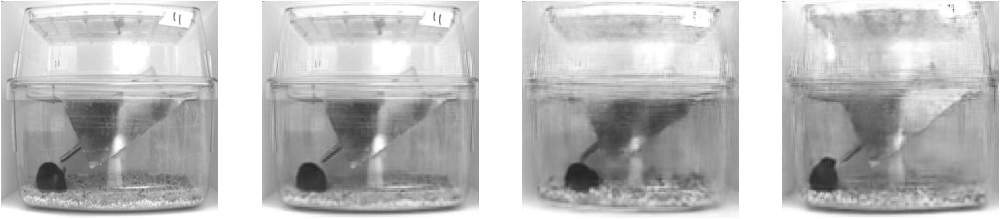

Change value of the latent at position 0 from -0.32964912 to 1.6703508794307709 (+) and -2.329649120569229 (-)


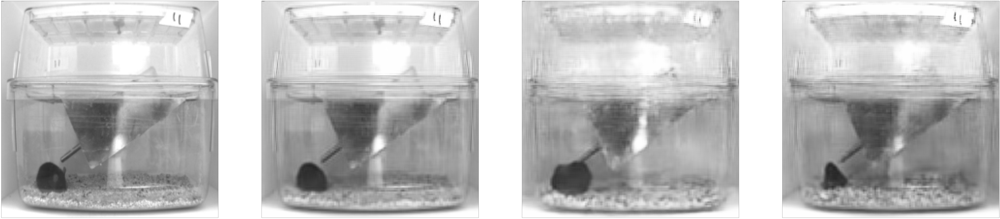

Change value of the latent at position 1 from -0.35077608 to 1.6492239236831665 (+) and -2.3507760763168335 (-)


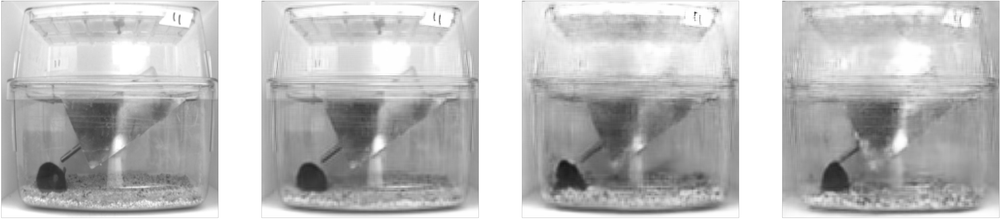

Change value of the latent at position 2 from 0.06297286 to 2.0629728585481644 (+) and -1.9370271414518356 (-)


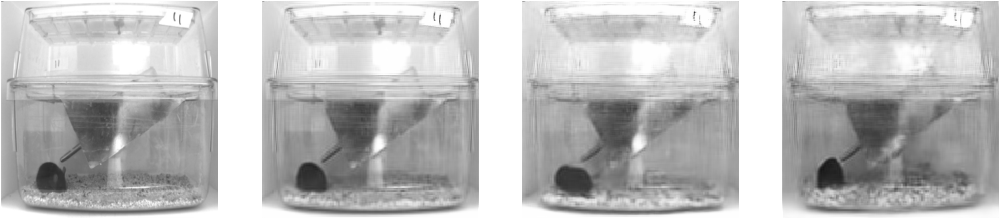

Change value of the latent at position 3 from 0.5982743 to 2.598274290561676 (+) and -1.401725709438324 (-)


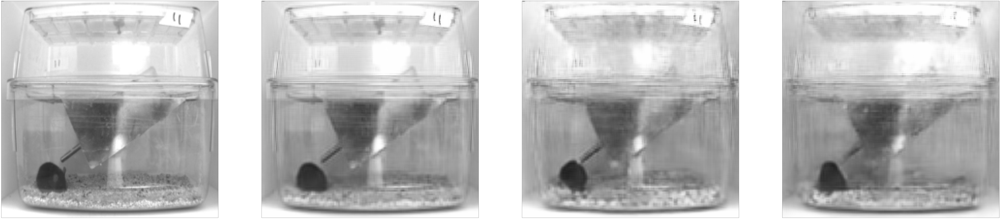

Change value of the latent at position 4 from 0.14397852 to 2.1439785212278366 (+) and -1.8560214787721634 (-)


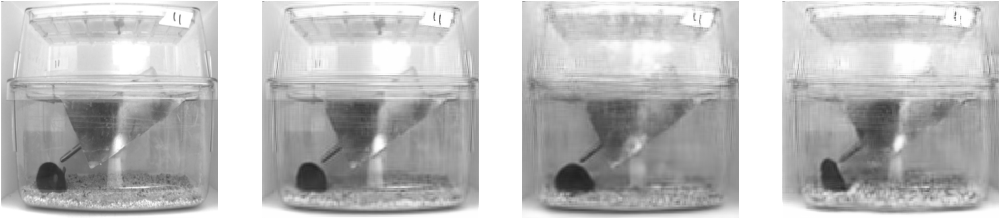

Change value of the latent at position 5 from -0.7415044 to 1.2584956288337708 (+) and -2.7415043711662292 (-)


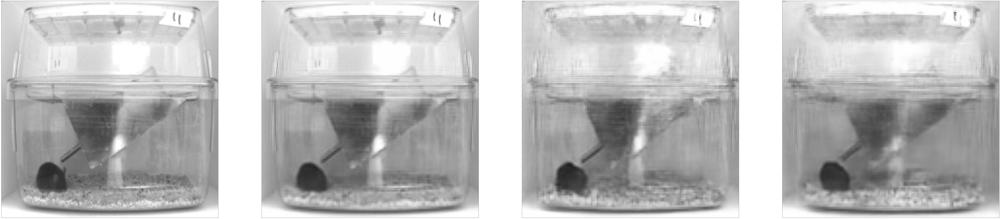

Change value of the latent at position 6 from 0.4603268 to 2.4603267908096313 (+) and -1.5396732091903687 (-)


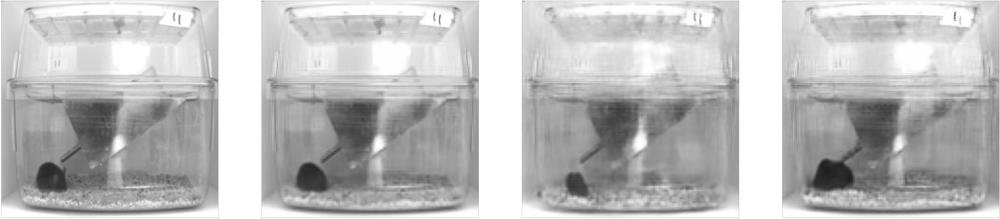

Change value of the latent at position 7 from -0.78166085 to 1.2183391451835632 (+) and -2.7816608548164368 (-)


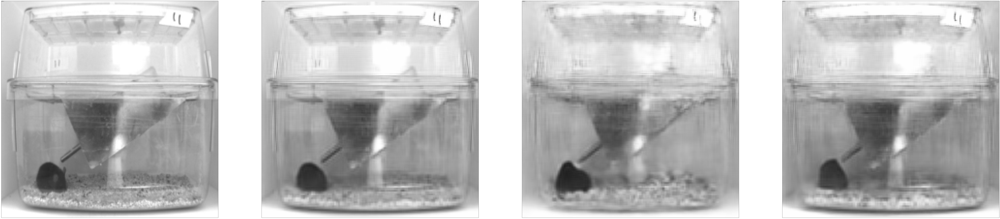

Change value of the latent at position 8 from -0.19579616 to 1.80420383810997 (+) and -2.19579616189003 (-)


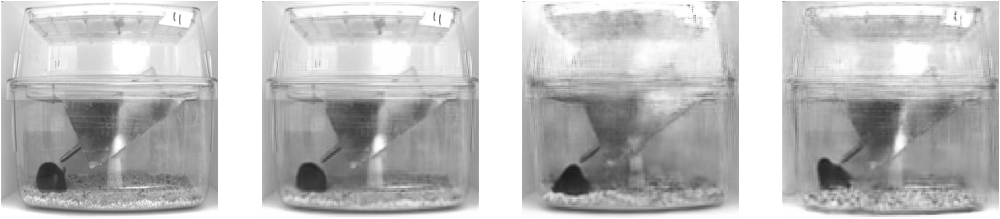

Change value of the latent at position 9 from 0.51777893 to 2.5177789330482483 (+) and -1.4822210669517517 (-)


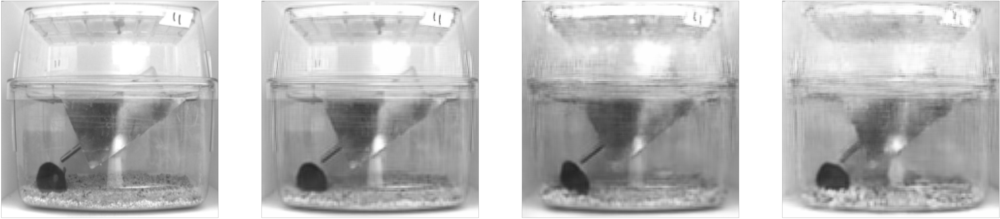

Change value of the latent at position 10 from 0.14421055 to 2.144210547208786 (+) and -1.855789452791214 (-)


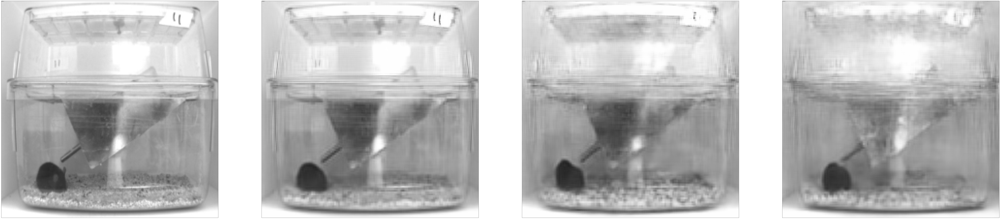

Change value of the latent at position 11 from 0.29729545 to 2.2972954511642456 (+) and -1.7027045488357544 (-)


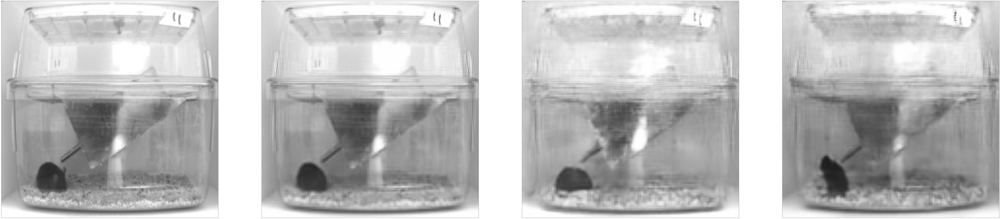

Change value of the latent at position 12 from 0.4352331 to 2.43523308634758 (+) and -1.56476691365242 (-)


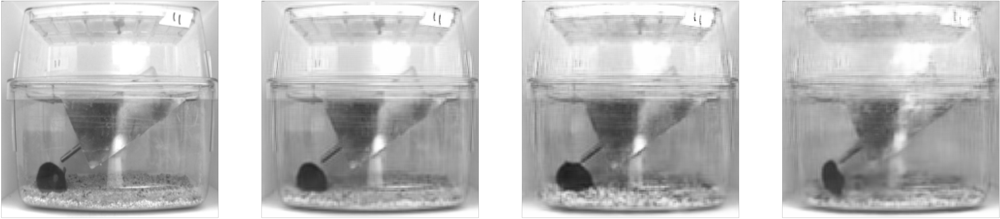

Change value of the latent at position 13 from 1.3772584 to 3.3772584199905396 (+) and -0.6227415800094604 (-)


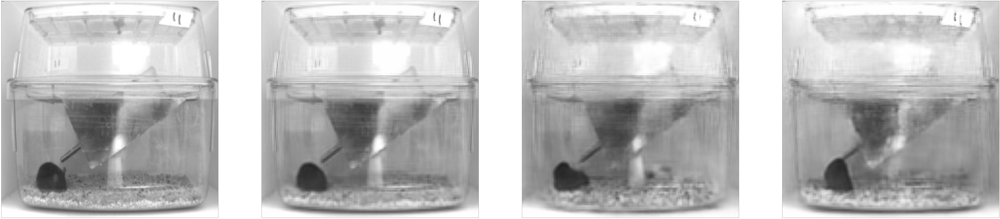

Change value of the latent at position 14 from 0.45603192 to 2.456031918525696 (+) and -1.5439680814743042 (-)


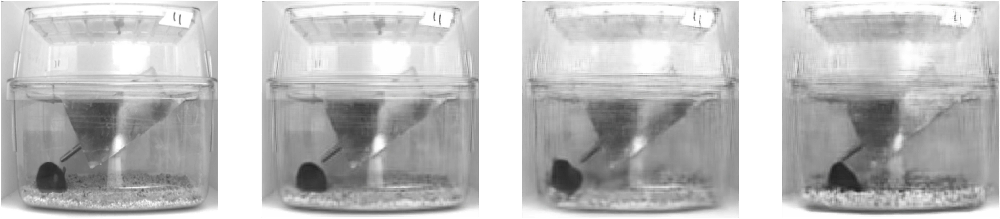

Change value of the latent at position 15 from 0.69312733 to 2.6931273341178894 (+) and -1.3068726658821106 (-)


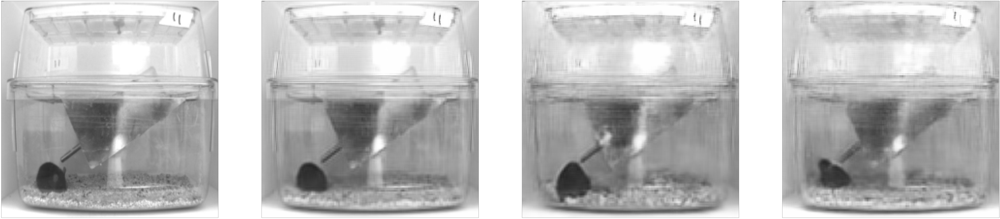

Change value of the latent at position 16 from -0.28173718 to 1.7182628214359283 (+) and -2.2817371785640717 (-)


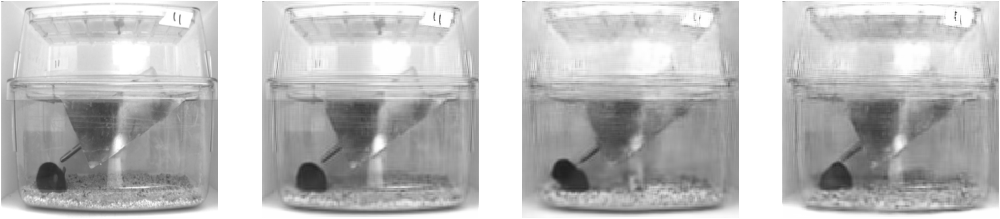

Change value of the latent at position 17 from 0.33280346 to 2.3328034579753876 (+) and -1.6671965420246124 (-)


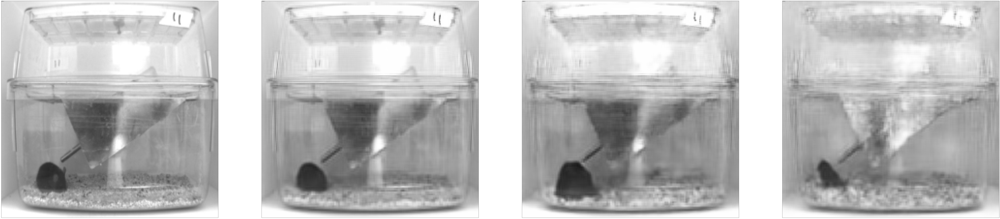

Change value of the latent at position 18 from 0.5631373 to 2.5631372928619385 (+) and -1.4368627071380615 (-)


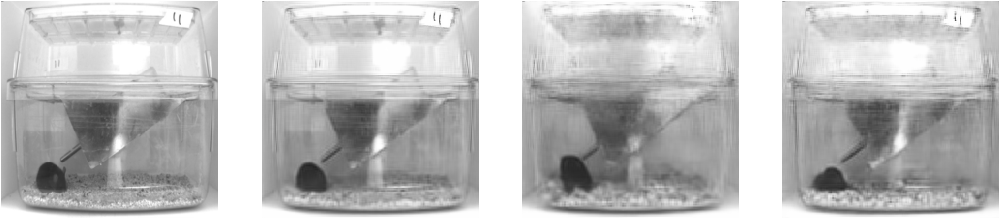

Change value of the latent at position 19 from -0.6074632 to 1.3925368189811707 (+) and -2.6074631810188293 (-)


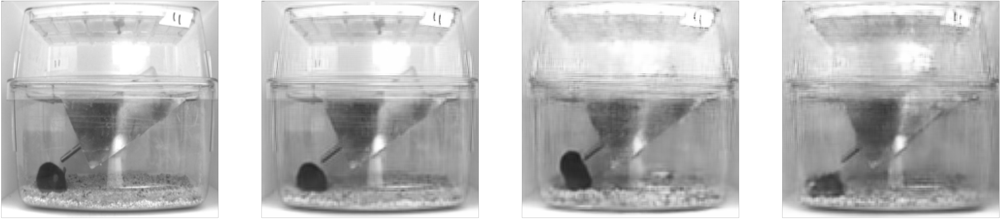

Change value of the latent at position 20 from 0.7001348 to 2.700134813785553 (+) and -1.299865186214447 (-)


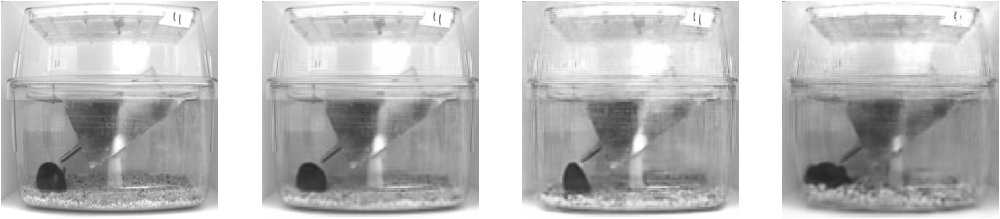

Change value of the latent at position 21 from 0.78012174 to 2.7801217436790466 (+) and -1.2198782563209534 (-)


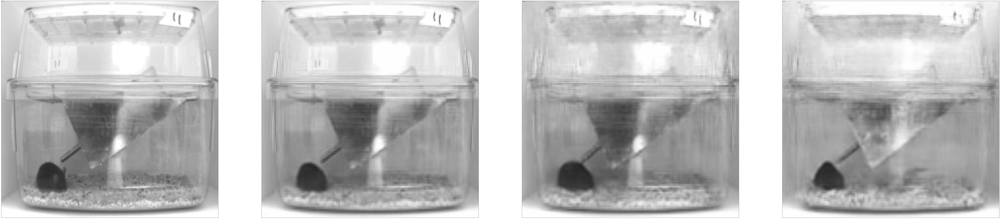

Change value of the latent at position 22 from 0.7388708 to 2.7388707995414734 (+) and -1.2611292004585266 (-)


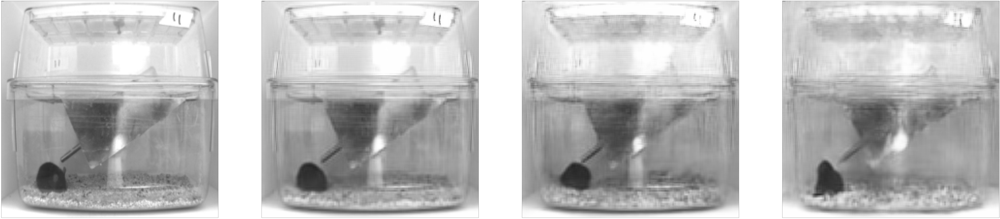

Change value of the latent at position 23 from -0.08012379 to 1.9198762103915215 (+) and -2.0801237896084785 (-)


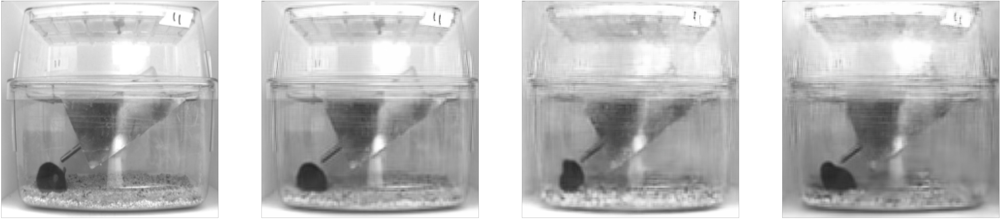

Change value of the latent at position 24 from 0.12476955 to 2.124769553542137 (+) and -1.8752304464578629 (-)


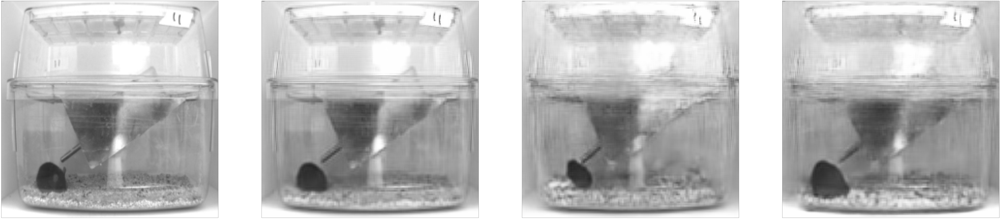

Change value of the latent at position 25 from -0.21111637 to 1.788883626461029 (+) and -2.211116373538971 (-)


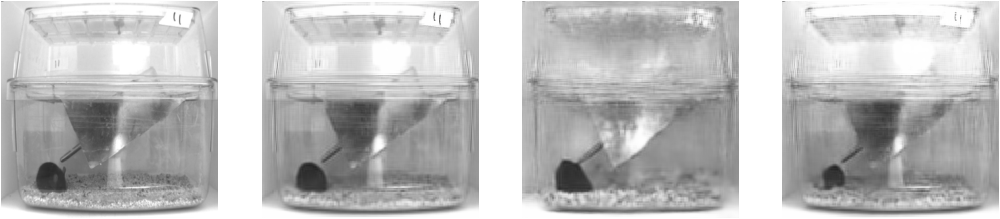

Change value of the latent at position 26 from -1.2389146 to 0.7610853910446167 (+) and -3.2389146089553833 (-)


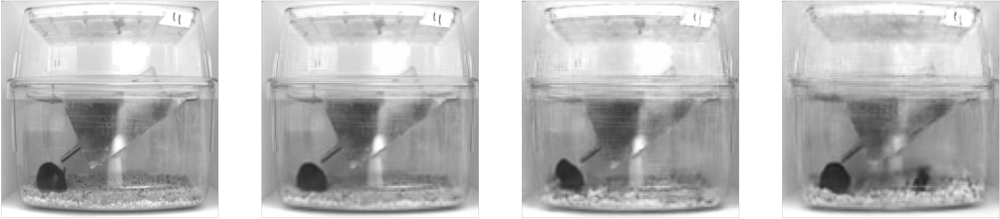

Change value of the latent at position 27 from 0.28492713 to 2.2849271297454834 (+) and -1.7150728702545166 (-)


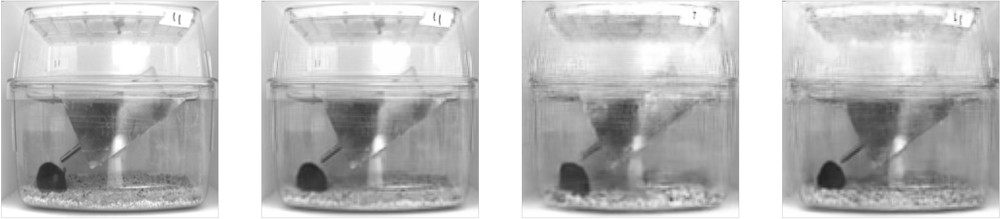

Change value of the latent at position 28 from 0.068046615 to 2.0680466145277023 (+) and -1.9319533854722977 (-)


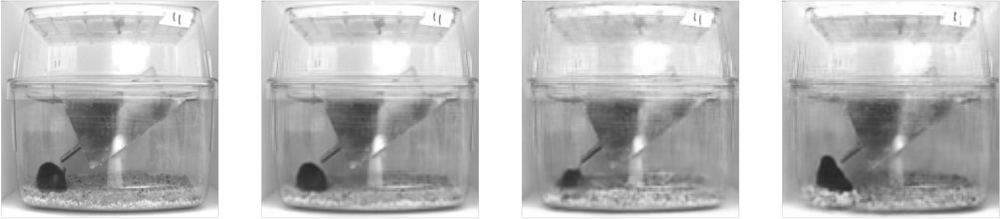

Change value of the latent at position 29 from -0.37764108 to 1.6223589181900024 (+) and -2.3776410818099976 (-)


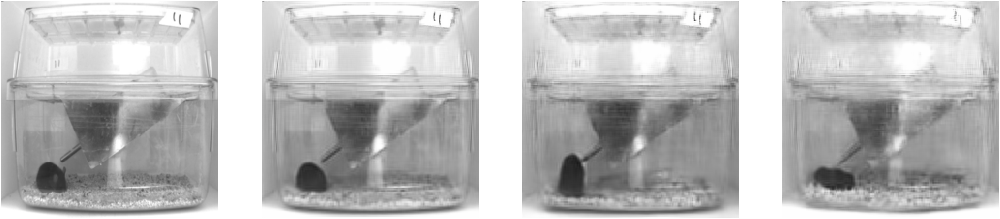

Change value of the latent at position 30 from 0.3314439 to 2.3314439058303833 (+) and -1.6685560941696167 (-)


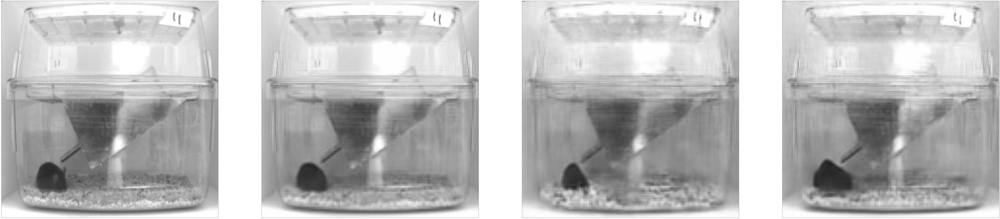

Change value of the latent at position 31 from -1.1750642 to 0.824935793876648 (+) and -3.175064206123352 (-)


In [141]:
model = newAE(32)
model = nn.DataParallel(model)
model = model.cuda()
model.load_state_dict(torch.load("new_architecture_MSE_e2400.p"))
model.eval()
plot_manipulated_latents(model, manipulation_value=2, image_index=39000)

<Figure size 14400x115200 with 0 Axes>

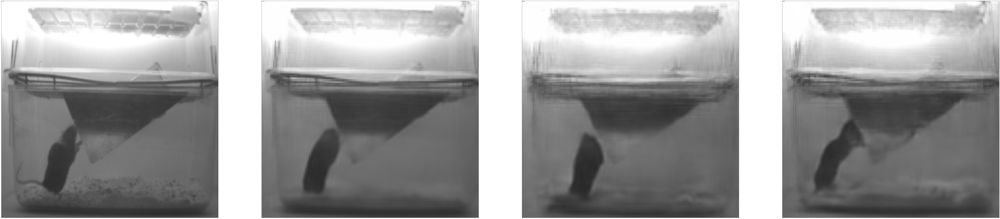

Change value of the latent at position 0 from -0.45094615 to 1.5490538477897644 (+) and -2.4509461522102356 (-)


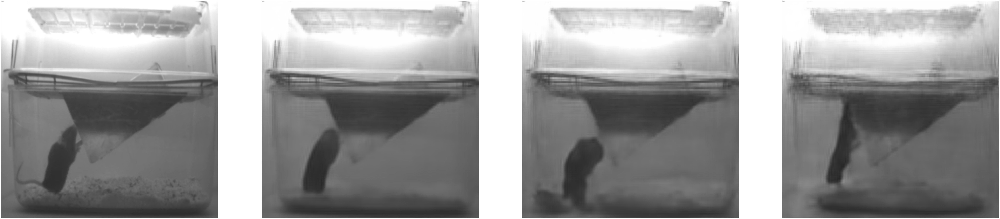

Change value of the latent at position 1 from 0.045040898 to 2.045040898025036 (+) and -1.9549591019749641 (-)


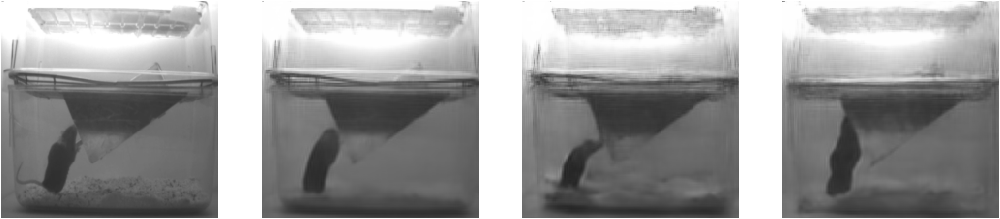

Change value of the latent at position 2 from 0.43296984 to 2.4329698383808136 (+) and -1.5670301616191864 (-)


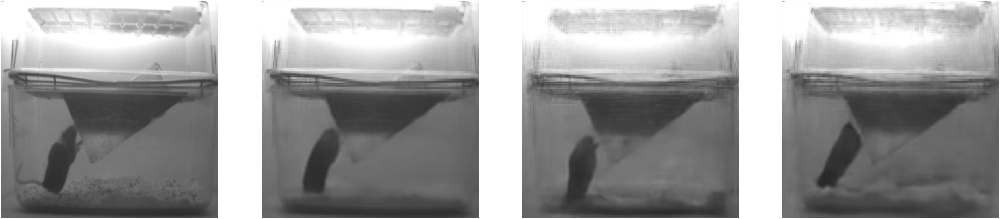

Change value of the latent at position 3 from -0.3795259 to 1.620474100112915 (+) and -2.379525899887085 (-)


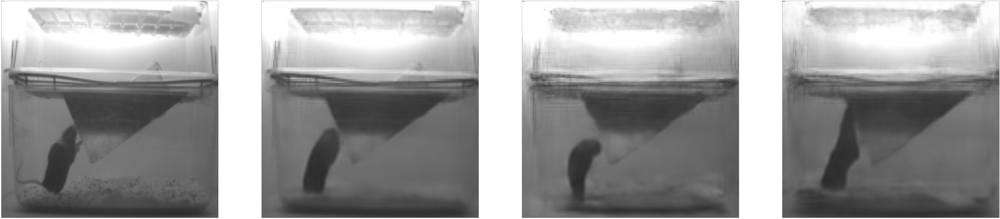

Change value of the latent at position 4 from 0.2667481 to 2.2667481005191803 (+) and -1.7332518994808197 (-)


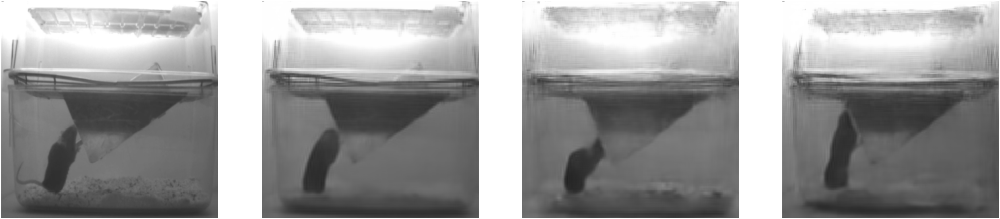

Change value of the latent at position 5 from -0.06167651 to 1.9383234903216362 (+) and -2.061676509678364 (-)


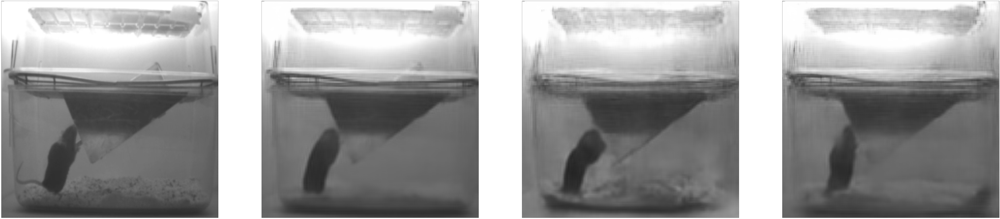

Change value of the latent at position 6 from -0.6701987 to 1.329801321029663 (+) and -2.670198678970337 (-)


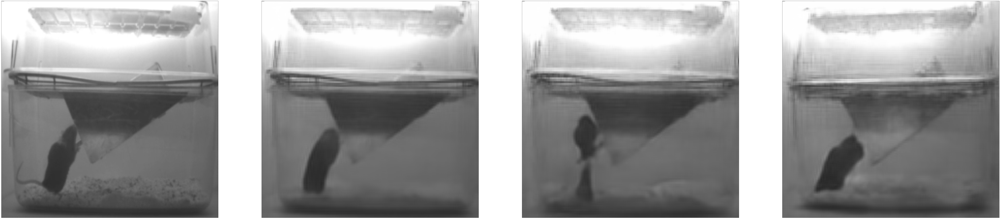

Change value of the latent at position 7 from -0.3961293 to 1.603870689868927 (+) and -2.396129310131073 (-)


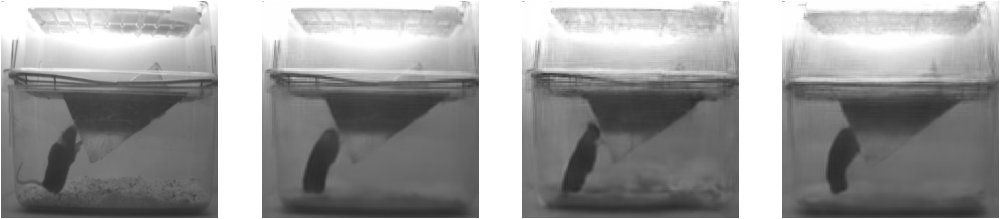

Change value of the latent at position 8 from -0.04653424 to 1.953465759754181 (+) and -2.046534240245819 (-)


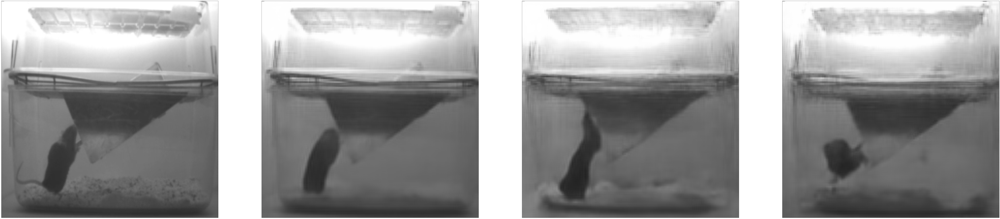

Change value of the latent at position 9 from 0.33656502 to 2.3365650177001953 (+) and -1.6634349822998047 (-)


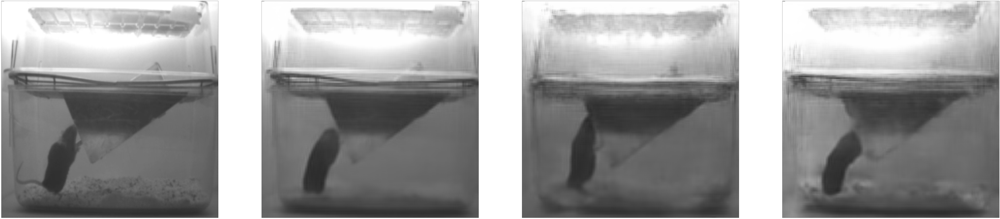

Change value of the latent at position 10 from 0.18659115 to 2.186591148376465 (+) and -1.8134088516235352 (-)


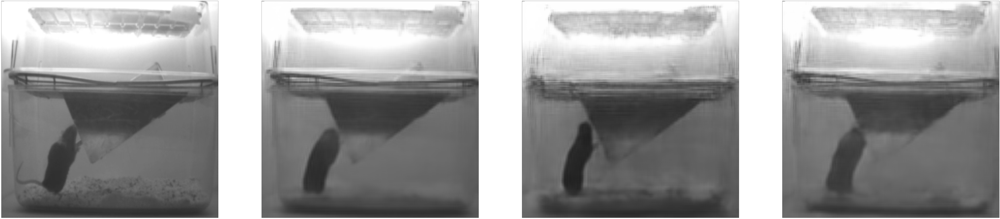

Change value of the latent at position 11 from -0.59572774 to 1.4042722582817078 (+) and -2.5957277417182922 (-)


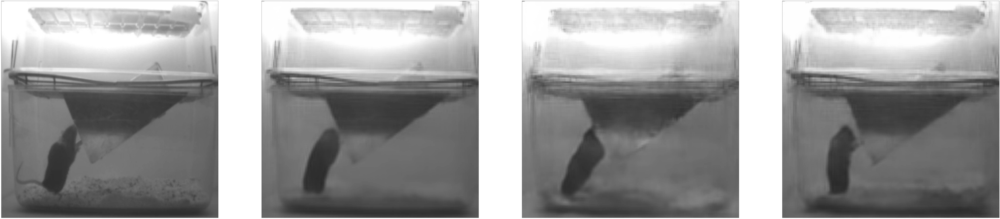

Change value of the latent at position 12 from -1.1031898 to 0.8968101739883423 (+) and -3.1031898260116577 (-)


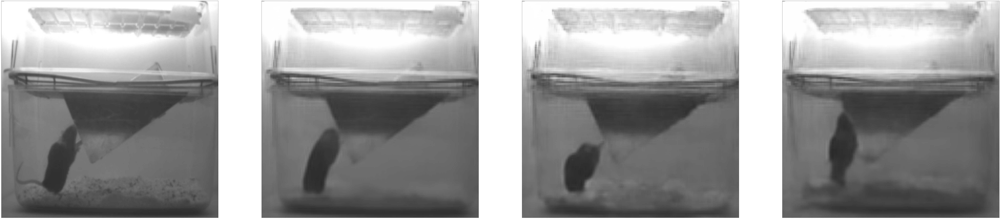

Change value of the latent at position 13 from 0.3301149 to 2.3301149010658264 (+) and -1.6698850989341736 (-)


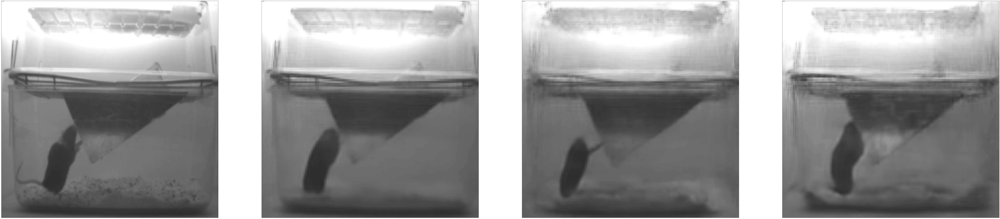

Change value of the latent at position 14 from -0.47602206 to 1.5239779353141785 (+) and -2.4760220646858215 (-)


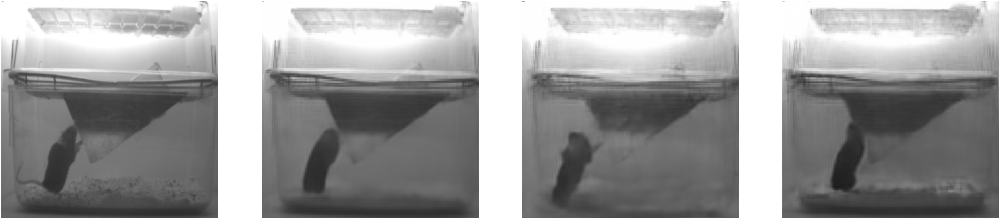

Change value of the latent at position 15 from 0.24161847 to 2.2416184693574905 (+) and -1.7583815306425095 (-)


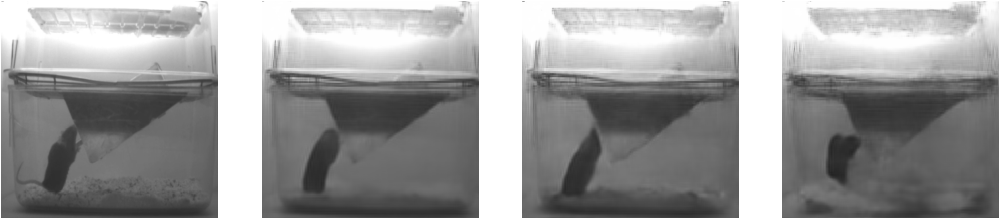

Change value of the latent at position 16 from 1.3465248 to 3.3465248346328735 (+) and -0.6534751653671265 (-)


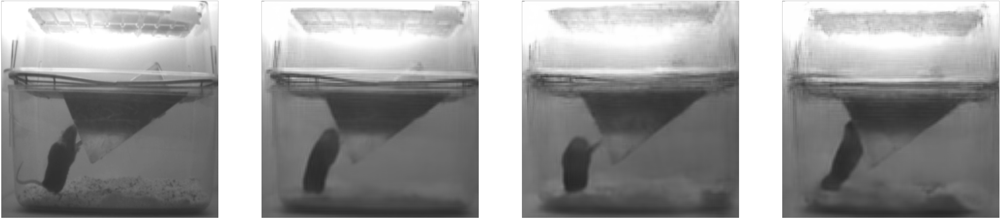

Change value of the latent at position 17 from 0.053622045 to 2.053622044622898 (+) and -1.946377955377102 (-)


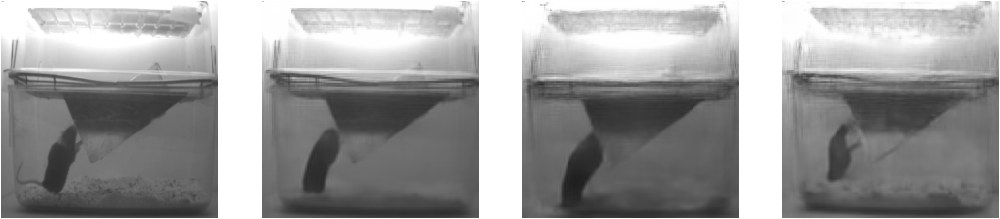

Change value of the latent at position 18 from 0.7009026 to 2.700902581214905 (+) and -1.2990974187850952 (-)


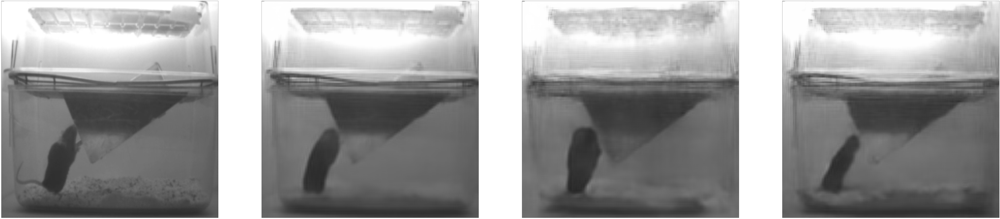

Change value of the latent at position 19 from -0.012815896 to 1.987184103578329 (+) and -2.012815896421671 (-)


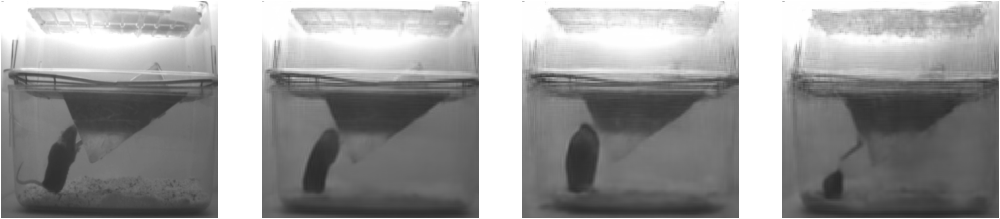

Change value of the latent at position 20 from 1.1880579 to 3.1880578994750977 (+) and -0.8119421005249023 (-)


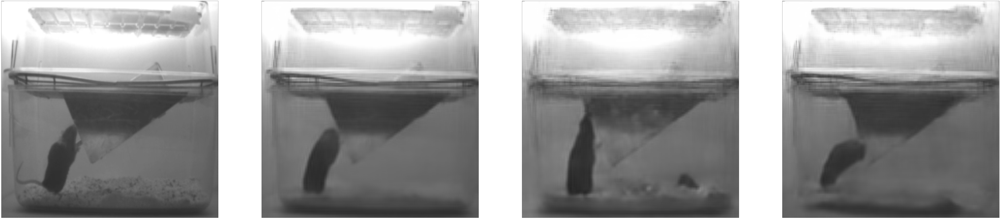

Change value of the latent at position 21 from -0.41660815 to 1.5833918452262878 (+) and -2.416608154773712 (-)


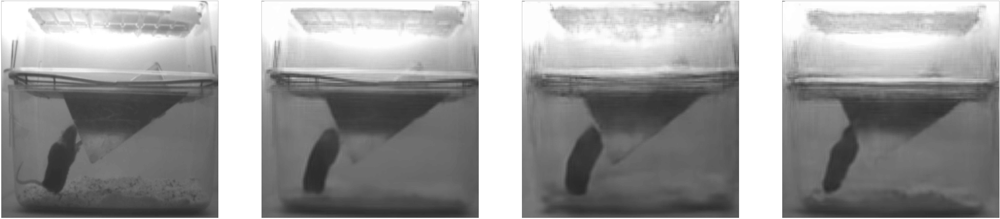

Change value of the latent at position 22 from -0.4129063 to 1.587093710899353 (+) and -2.412906289100647 (-)


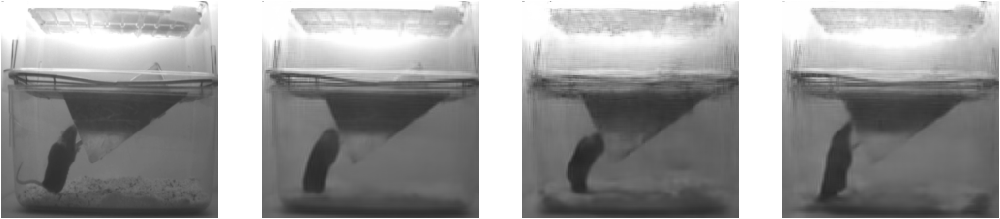

Change value of the latent at position 23 from 0.4686353 to 2.4686352908611298 (+) and -1.5313647091388702 (-)


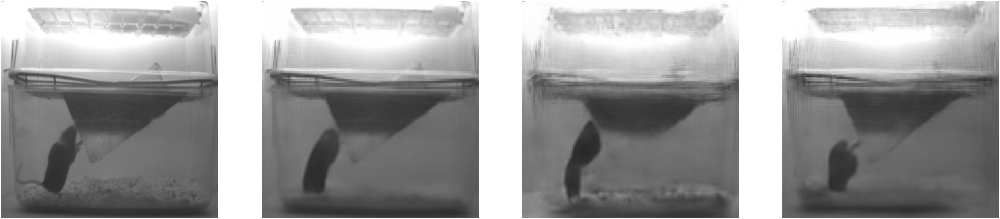

Change value of the latent at position 24 from -0.36854342 to 1.631456583738327 (+) and -2.368543416261673 (-)


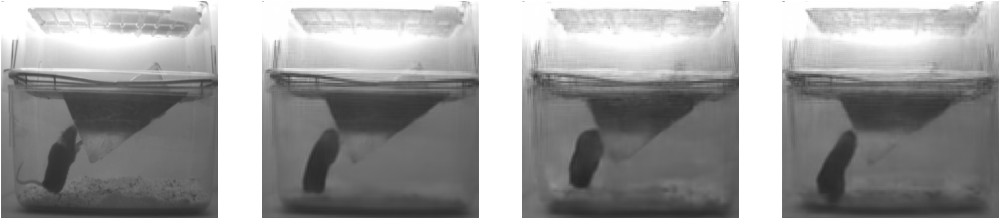

Change value of the latent at position 25 from 0.24079926 to 2.2407992631196976 (+) and -1.7592007368803024 (-)


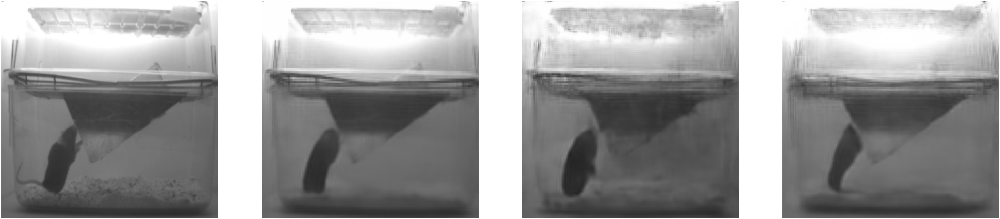

Change value of the latent at position 26 from -0.82203025 to 1.177969753742218 (+) and -2.822030246257782 (-)


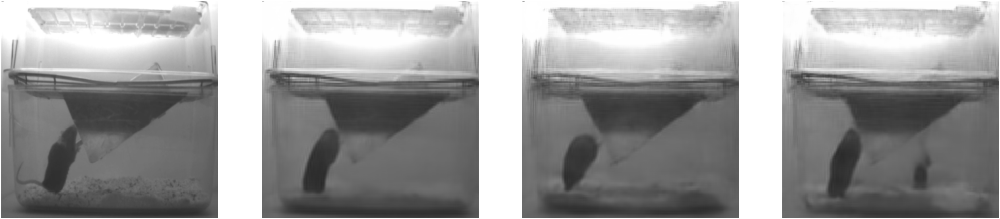

Change value of the latent at position 27 from -0.11526673 to 1.8847332671284676 (+) and -2.1152667328715324 (-)


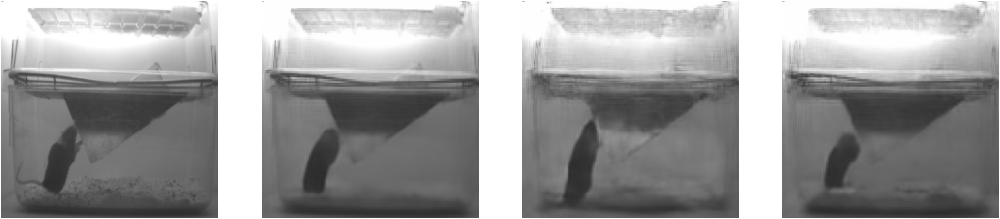

Change value of the latent at position 28 from -0.86915 to 1.1308500170707703 (+) and -2.8691499829292297 (-)


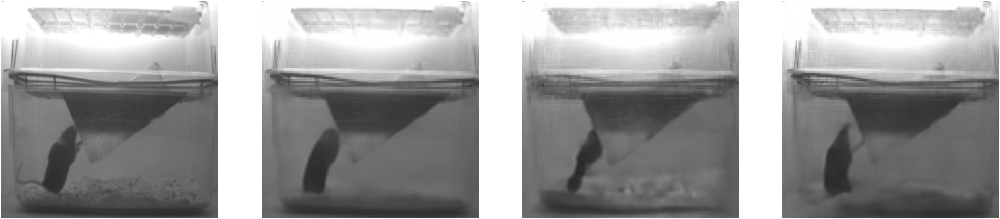

Change value of the latent at position 29 from -0.7375718 to 1.2624282240867615 (+) and -2.7375717759132385 (-)


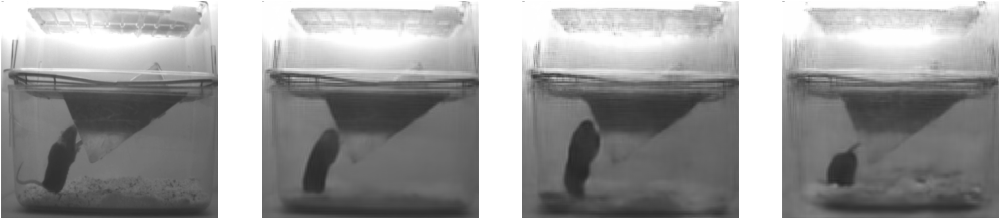

Change value of the latent at position 30 from 2.0738058 to 4.073805809020996 (+) and 0.0738058090209961 (-)


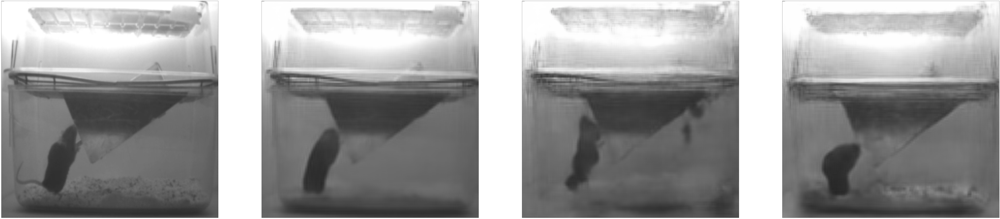

Change value of the latent at position 31 from 0.12201384 to 2.1220138370990753 (+) and -1.8779861629009247 (-)


In [136]:
plot_manipulated_latents(model, manipulation_value=2, image_index=12375)

### Visualizing the Latents over 100 samples

In [97]:
n = 100
individual_latents = []
counts = [i for i in range(n)]
for i in range(n):
        # Get Target Image
        img = valid_set_loader.dataset[i].unsqueeze(0).cuda()
        
        model.eval()
        with torch.no_grad():
            if len(model(img))>1:
                # This case doesn't usually occur, but leaving it here for easier debugging
                rec_img, _, _  = model(img)
            else:
                # Getting the Latent representation
                latent_representation = model.module.encoder(img).squeeze().cpu().numpy()
                individual_latents.append(latent_representation)

/home/anagara8/.conda/envs/pytorch/lib/python3.9/site-packages/torch/nn/functional.py:3631: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn(


In [98]:
latent_dataframe = pd.DataFrame(individual_latents)
counts_df = pd.DataFrame(counts)

In [99]:
latent_dataframe.insert(32, "Time", counts, True)

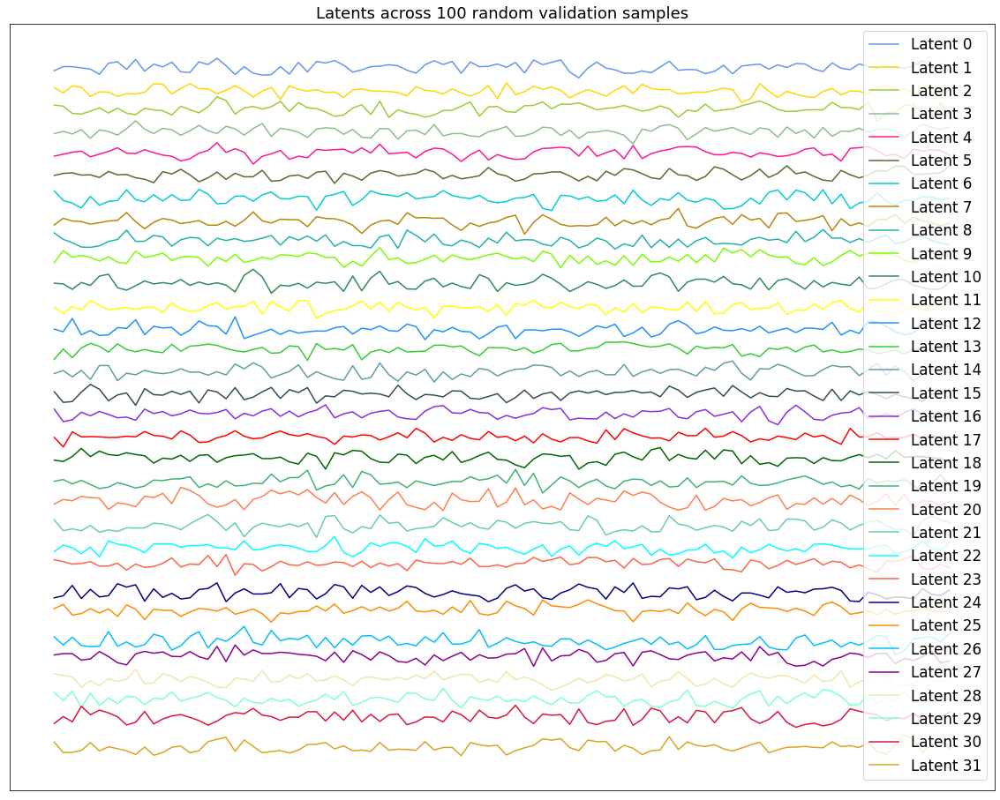

In [134]:
colours = ["#DC143C", "#FF0000", "#FF7F50", "#FF6347", 
           "#FF8C00", "#FFD700", "#B8860B", "#DAA520", 
           "#EEE8AA", "#FFFF00", "#9ACD32", "#556B2F", 
           "#7CFC00", "#006400", "#32CD32", "#8FBC8F",
           "#2E8B57", "#66CDAA", "#3CB371", "#20B2AA",
           "#2F4F4F", "#00FFFF", "#00CED1", "#7FFFD4",
           "#5F9EA0", "#FF1493", "#6495ED", "#00BFFF",
           "#1E90FF", "#000080", "#8A2BE2", "#8B008B"]

random.seed(42)
random.shuffle(colours)

for i in range(32):
    plt.plot(latent_dataframe["Time"], list(map(lambda x:x-((i+1)*2.5), latent_dataframe[i])), color=colours[i], label='Latent '+str(i))
# Plotting batches of latents:
#     if (i+1)%4 == 0:
#         print(i)
#         plt.rcParams["figure.figsize"] = (20,8)
#         plt.legend(loc='upper right')
#         plt.show()
plt.title("Latents across 100 random validation samples", fontsize=18)
plt.xticks([])
plt.yticks([])
plt.rcParams["figure.figsize"] = (20,16)
plt.legend(loc='upper right',prop={'size': 16.735})
plt.show()

### Confusion Matrix of the Latent Correlations

In [101]:
# Euclidean Distance as the similarity metric between latents
def euclidean_distance(x,y):
    return math.sqrt(sum(pow(a-b,2) for a, b in zip(x, y)))

In [102]:
conf = np.zeros((32, 32))

for i in range(32):
    for j in range(32):
        conf[i][j] = euclidean_distance(latent_dataframe[i], latent_dataframe[j])

<AxesSubplot:title={'center':'Latent Correlations using Euclidean Distances'}>

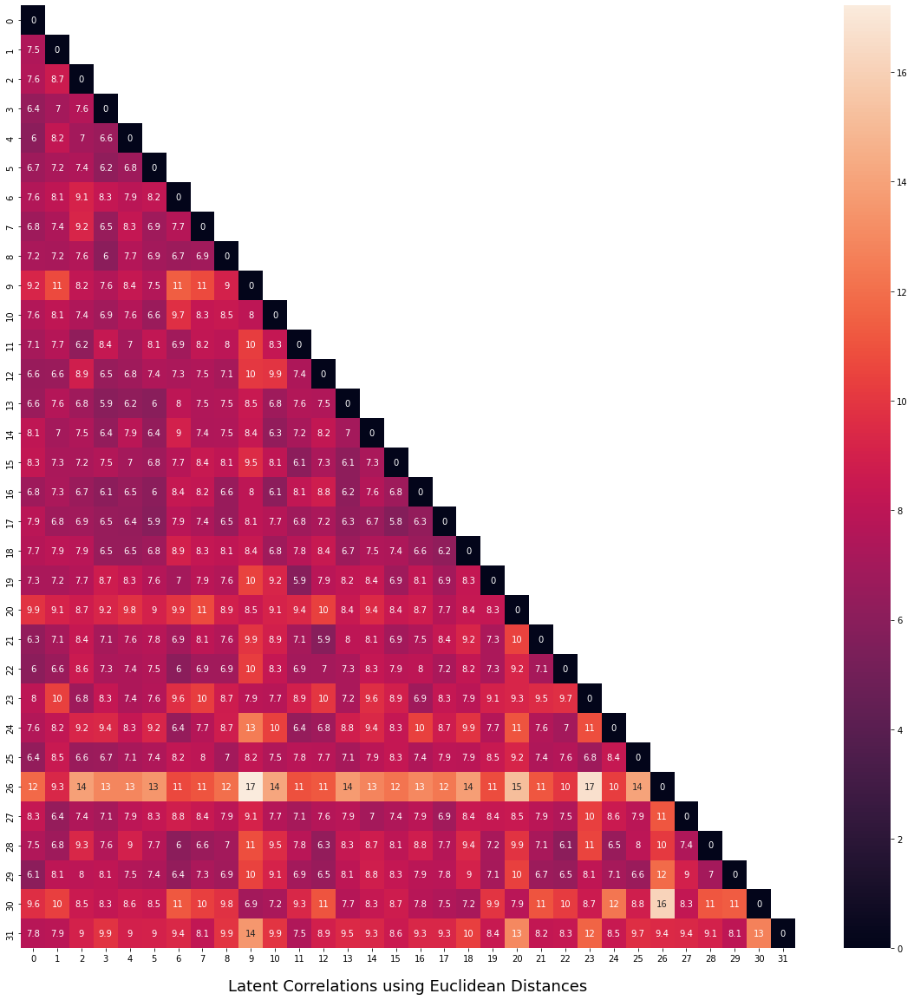

In [108]:
# Mask to make it a Lower Triangular Matrix:
matrix = np.triu(conf)

plt.figure(figsize = (20,20))
plt.title("Latent Correlations using Euclidean Distances", y=-0.05, fontsize=18)
sn.heatmap(conf, annot=True, mask = matrix)